## Traitement d'Images TP1 
(KOFFI DELADEM MOISE ETOU,
AKOIUETE YAYRA HUGUES AGBODAZE,
Axel Piasecki,
Alexandre Lambert,Amadou Cupidon Sy,Alexandra ZEPHIRIN)

In [ ]:
#importation
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np

In [13]:
## Configuration Traitement par lot 
# Chemin du dossier racine contenant les sous-dossiers
root_dir = r"./Colab/"
sub_dirs = ['Chambre', 'Salon', 'Cuisine']
image_ref_name = "Reference.JPG"

### Phase 1 : Prétraitement
(Améliorer la qualité de l'image, par exemple, en supprimant le bruit et en corrigeant les distorsions.)

In [14]:
# Redimensionnement
def resizer_image(image, scale_percent):
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
    return cv2.resize(image, dim, interpolation=cv2.INTER_AREA)

In [15]:
#Gestion de l' ajustement des images en fonction de l'angle de prise

def aligner_images(img_ref, img_act, max_features=500, good_match_percent=0.15):
    # Vérifier si les images sont en RGB et les convertir en niveaux de gris
    gris_ref = cv2.cvtColor(img_ref, cv2.COLOR_RGB2GRAY)
    gris_act = cv2.cvtColor(img_act, cv2.COLOR_RGB2GRAY)

    # Initialiser le détecteur ORB avec des paramètres ajustés
    orb = cv2.ORB_create(nfeatures=max_features)

    # Détection des  points clés et calculer les descripteurs
    kp1, des1 = orb.detectAndCompute(gris_ref, None)
    kp2, des2 = orb.detectAndCompute(gris_act, None)

    # Vérifier que des descripteurs ont été trouvés
    if des1 is None or des2 is None:
        raise ValueError("Pas assez de points clés détectés pour l'alignement.")

    # Initialisation du matcher BFMatcher avec KNN
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=False)

    # Trouver les correspondances avec KNN
    matches = bf.knnMatch(des1, des2, k=2)

    # Appliquer le ratio test de Lowe
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)

    print(f"Nombre de bonnes correspondances après le ratio test : {len(good_matches)}")

    # Vérifier qu'il y a suffisamment de bonnes correspondances
    if len(good_matches) < 4:
        raise ValueError("Pas assez de bonnes correspondances pour calculer l'homographie.")

    # Limiter le nombre de bonnes correspondances
    good_matches = sorted(good_matches, key=lambda x: x.distance)
    good_matches = good_matches[:int(len(good_matches) * good_match_percent)]

    # Extraire les points de correspondance
    pts1 = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    pts2 = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    # Calculer l'homographie
    homographie, mask = cv2.findHomography(pts2, pts1, cv2.RANSAC, 5.0)

    if homographie is None:
        raise ValueError("Homographie non trouvée.")

    # Appliquer la transformation homographique à l'image actuelle
    img_act_alignee = cv2.warpPerspective(img_act, homographie, (img_ref.shape[1], img_ref.shape[0]))

    # Visualisation les correspondances avec Matplotlib
    img_matches = cv2.drawMatches(img_ref, kp1, img_act, kp2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    return img_act_alignee ,img_matches


In [16]:
# Traitement dans l'espace colorimétrique HSV 
def appliquer_clahe_hsv(image, clip_limit=2.0, tile_grid_size=(8, 8)):

    # Convertir l'image de RGB à HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    
    # Séparer les canaux H, S, V
    h, s, v = cv2.split(hsv)
    
    # Initialiser CLAHE avec les paramètres spécifiés
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    
    # Appliquer CLAHE uniquement sur le canal V
    v_clahe = clahe.apply(v)
    
    # Recomposer l'image HSV avec le canal V amélioré
    hsv_clahe = cv2.merge((h, s, v_clahe))
    
    # Convertir l'image HSV de retour en BGR
    image_clahe = cv2.cvtColor(hsv_clahe, cv2.COLOR_HSV2RGB)
    
    return image_clahe


In [17]:
def appliquer_clahe_rgb(image, clip_limit=2.0, tile_grid_size=(8, 8)):

    # Séparer les canaux R,G,B
    r, g, b = cv2.split(image)
    
    # Appliquer CLAHE sur chaque canal
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
 
    r_clahe = clahe.apply(r)
    g_clahe = clahe.apply(g)
    b_clahe = clahe.apply(b)

    
    # Recomposer l'image
    image_clahe = cv2.merge((r_clahe, g_clahe,b_clahe ))

    
    return image_clahe

In [18]:
# Méthode pour fusionner les deux résultats (LAB et HSV) avec des pondérations
def fusionner_images(image1, image2, alpha=0.5, beta=0.5):
    image_fusionnee = cv2.addWeighted(image1, alpha, image2, beta, 0)
    return image_fusionnee

### Phase 2 : Segmentation
✓ Diviser l'image en régions ou objets significatifs pour une analyse plus approfondie.

In [19]:
# detection de la difference

def soustraction_arriere_plan(img_ref_alignee, img_trait_alignee):
    # Convertir en niveaux de gris
    gray_ref = cv2.cvtColor(img_ref_alignee, cv2.COLOR_RGB2GRAY)
    gray_trait = cv2.cvtColor(img_trait_alignee, cv2.COLOR_RGB2GRAY)

    #image_gris_ref_equal = cv2.equalizeHist(gray_ref)
    #image_gris_act_equal = cv2.equalizeHist(gray_trait)
    
    # Calculer la différence absolue
    diff = cv2.absdiff(gray_ref, gray_trait)
    
    # Appliquer un seuillage pour obtenir une image binaire
    #_, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)
        #_, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY_INV)
    #_, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    #_, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_TRUNC)
    #_, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_TOZERO)
    #_, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_TOZERO_INV)
    _, mask = cv2.threshold(diff, 30, 255, cv2.THRESH_TRIANGLE)

    #mask  = cv2.adaptiveThreshold(diff, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
    
    # Opérations morphologiques pour éliminer le bruit
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
   
   
    return mask

### Phase 3 : Extraction des caractéristiques

✓ Identifier et extraire des attributs importants (contours, formes, textures) des régions segmentées.

In [20]:

# Fonction de détection de contours
def detecter_contours(mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return contours 


### Phase 4 : Classification / Détection d'objets (Filtrage des contours)

In [21]:
#fonction pour tracer les contours
def tracer_contour(image_originale, contours, min_area=100, max_area=10000, color=(0, 255, 0), thickness=3):
    # Copier l'image originale pour dessiner les rectangles
    image_contours = image_originale.copy()

    # Filtrer les contours en fonction de leur aire
    filtered_contours = [cnt for cnt in contours if min_area < cv2.contourArea(cnt) < max_area]

    for cnt in filtered_contours:
        # Obtenir le rectangle englobant aligné aux axes
        x, y, w, h = cv2.boundingRect(cnt)
        cv2.rectangle(image_contours, (x, y), (x + w, y + h), color, thickness)

    return image_contours

### Phase 5 : Pipeline complet d'excecution 

Nombre de bonnes correspondances après le ratio test : 117


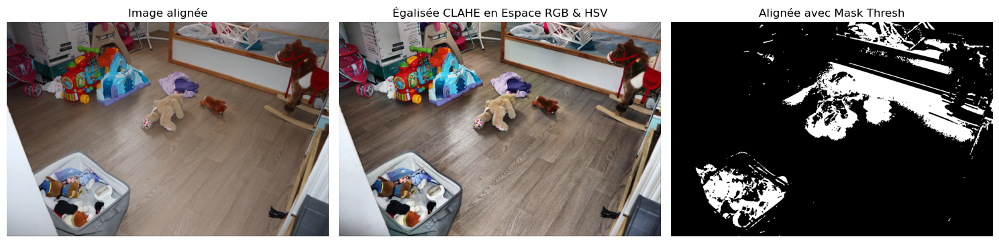

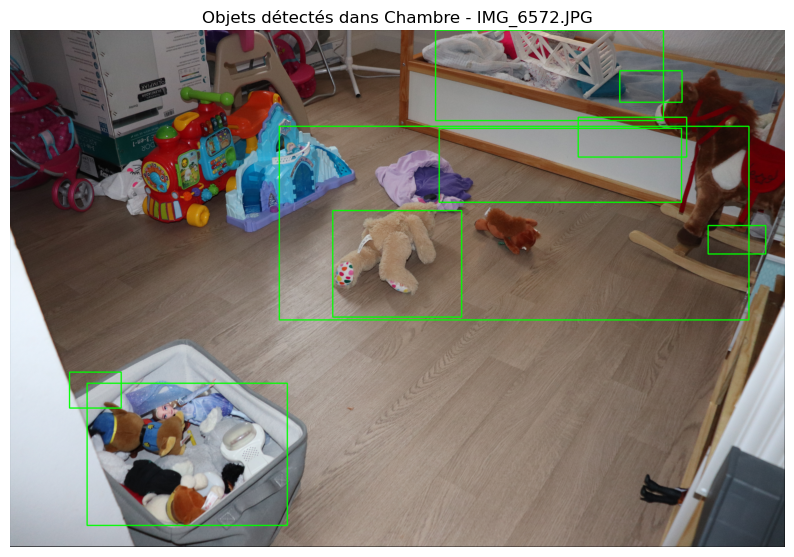

Nombre de bonnes correspondances après le ratio test : 311


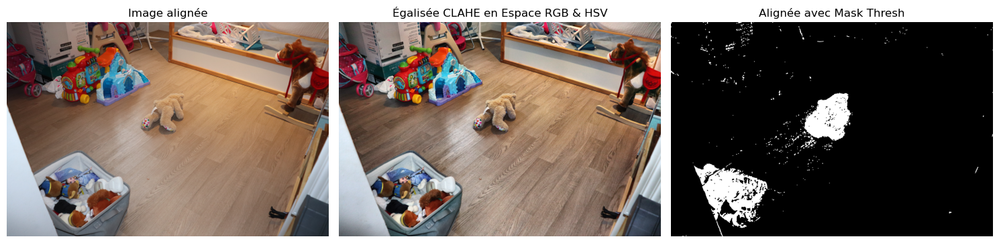

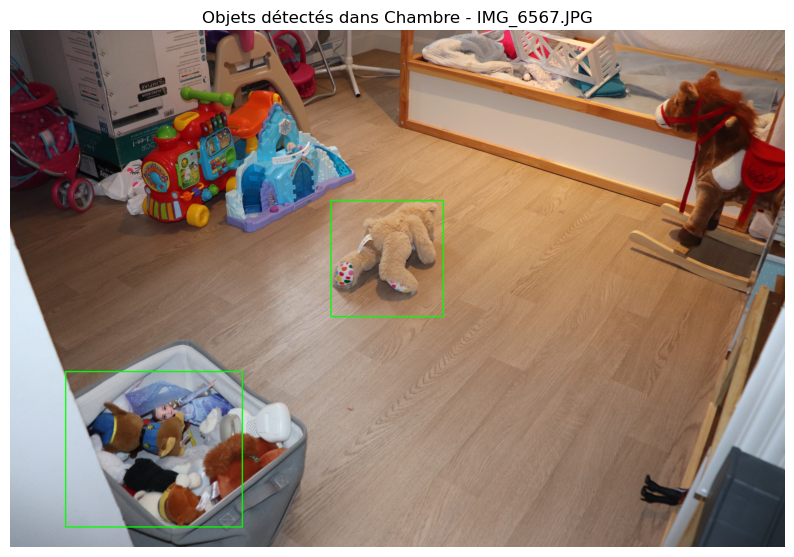

Nombre de bonnes correspondances après le ratio test : 264


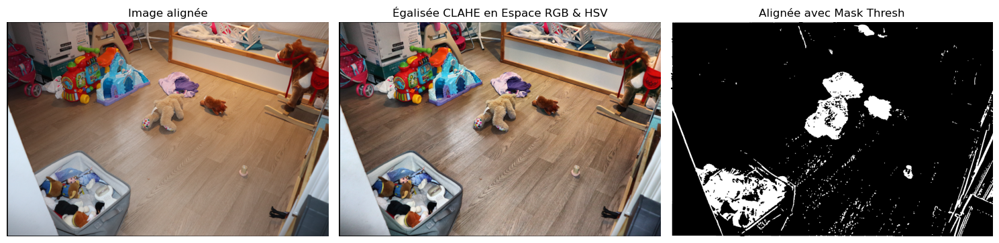

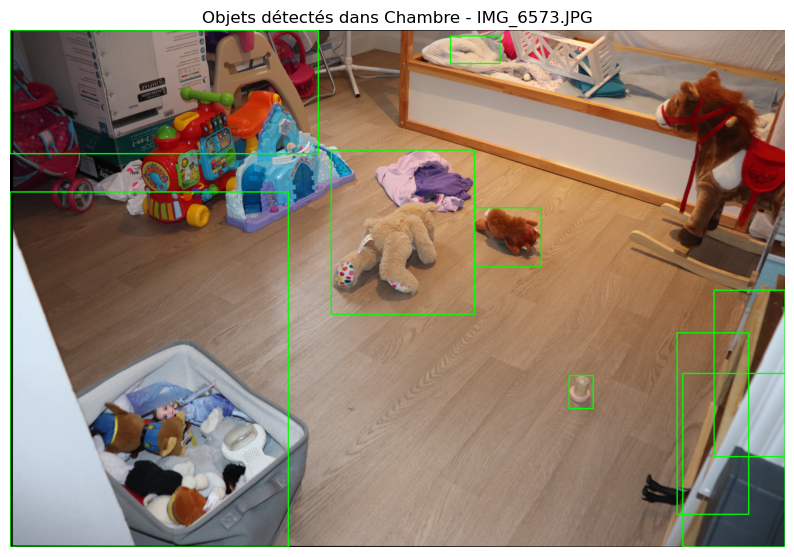

Nombre de bonnes correspondances après le ratio test : 50


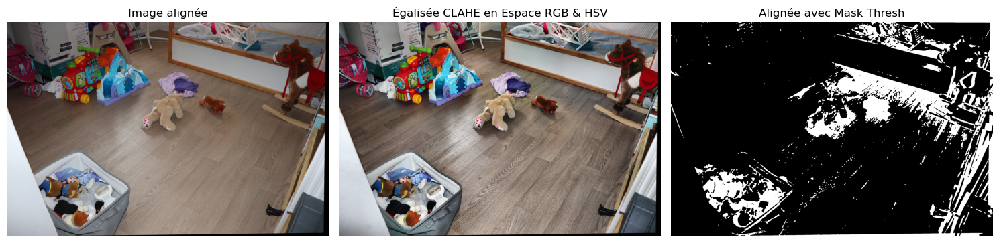

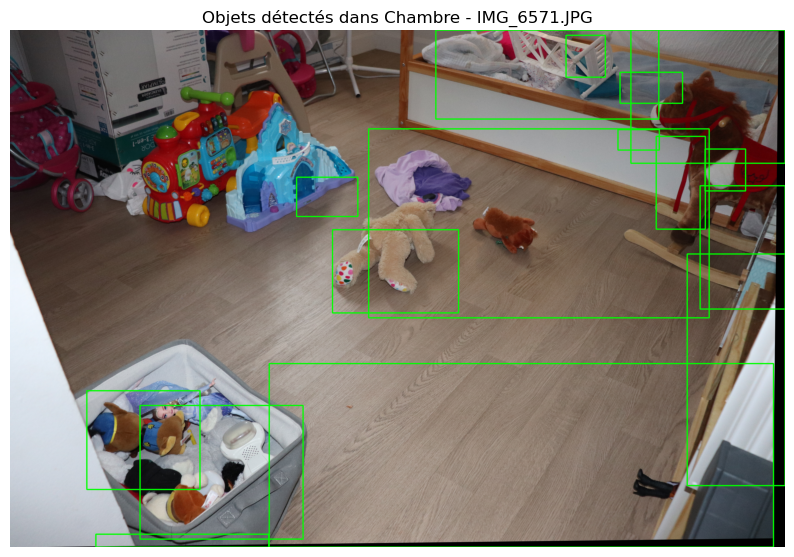

Nombre de bonnes correspondances après le ratio test : 208


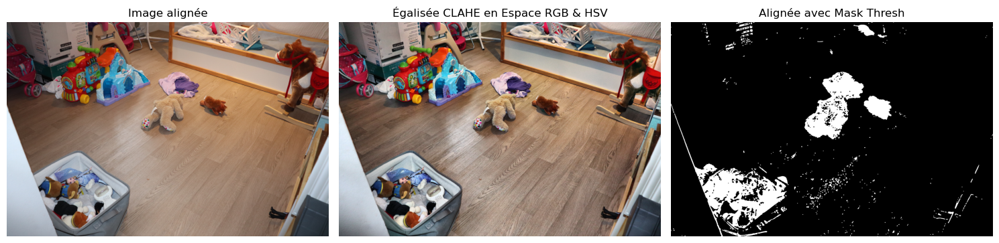

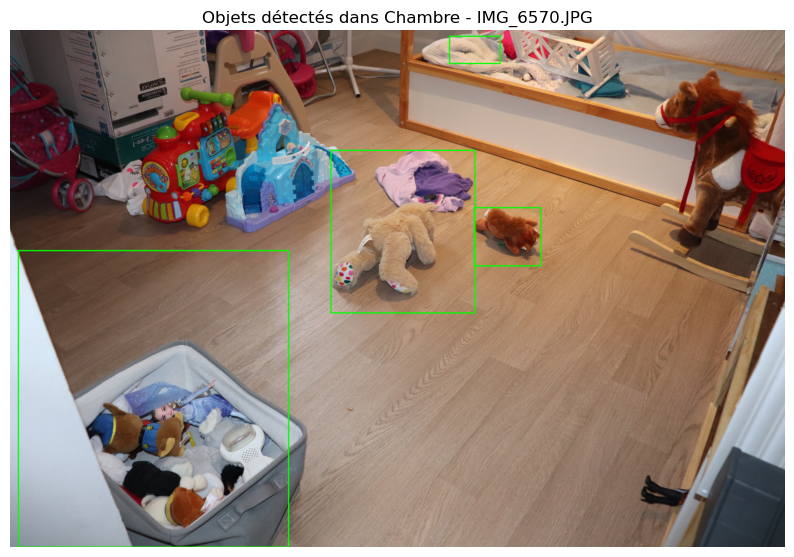

Nombre de bonnes correspondances après le ratio test : 225


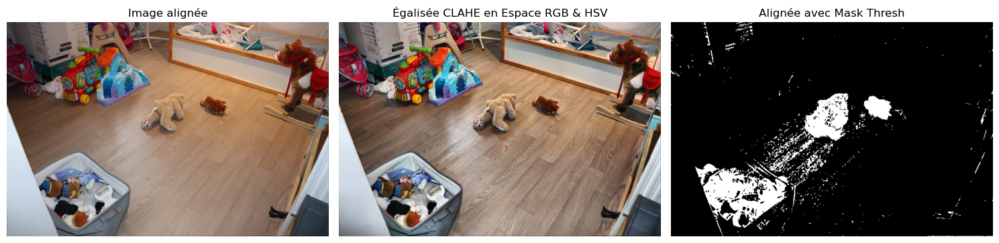

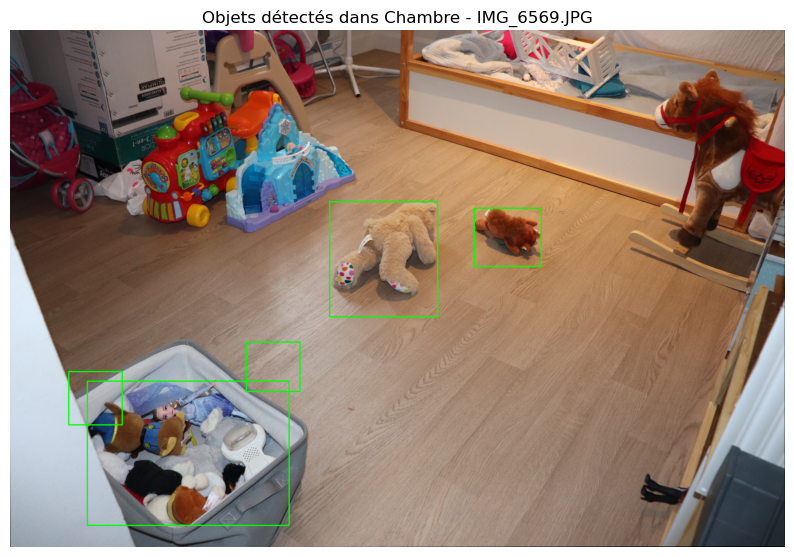

Nombre de bonnes correspondances après le ratio test : 164


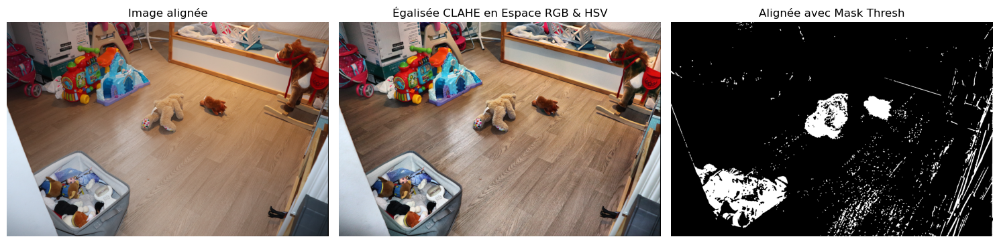

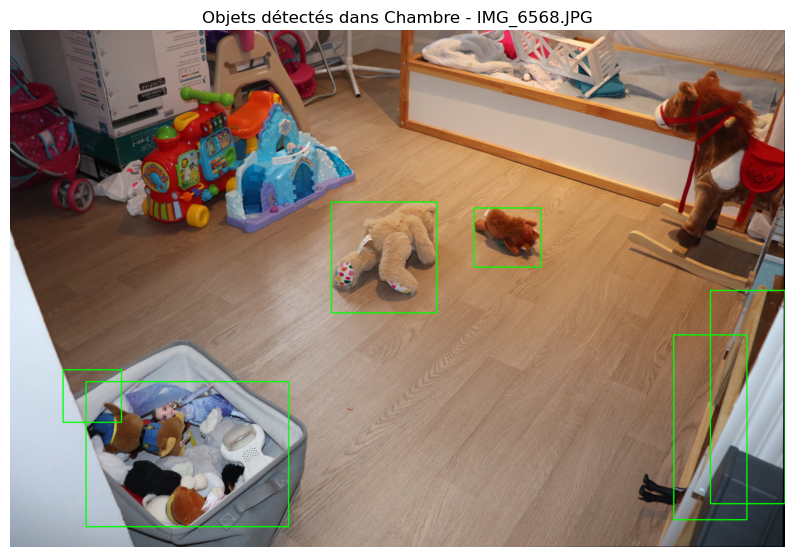

Nombre de bonnes correspondances après le ratio test : 144


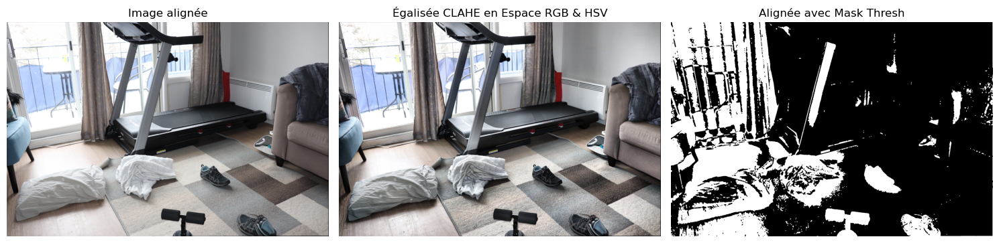

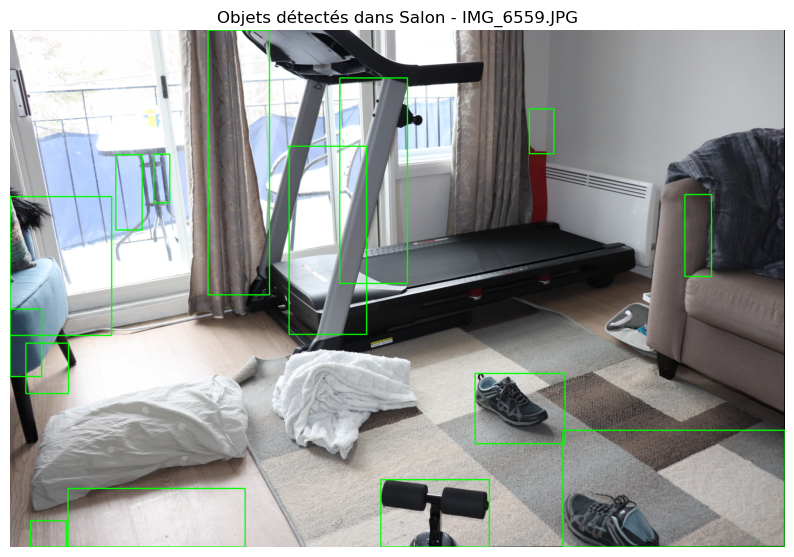

Nombre de bonnes correspondances après le ratio test : 152


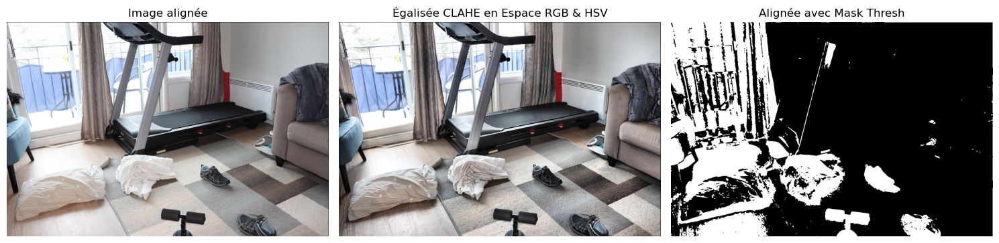

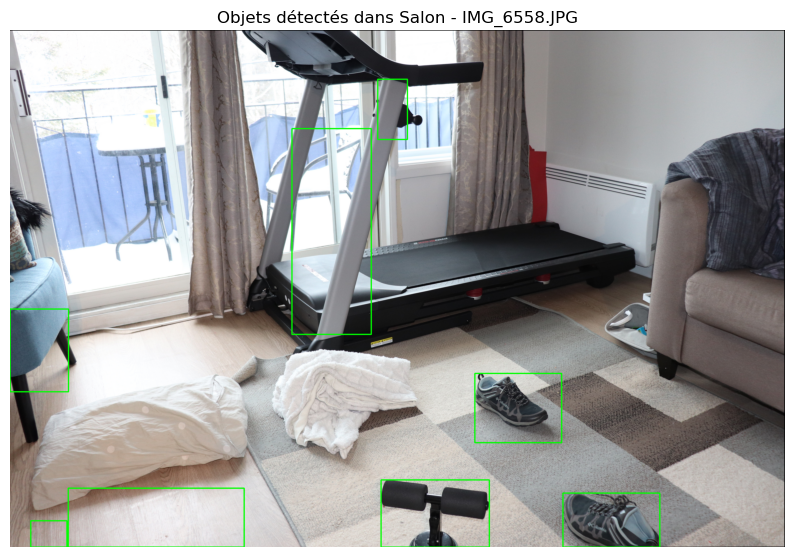

Nombre de bonnes correspondances après le ratio test : 213


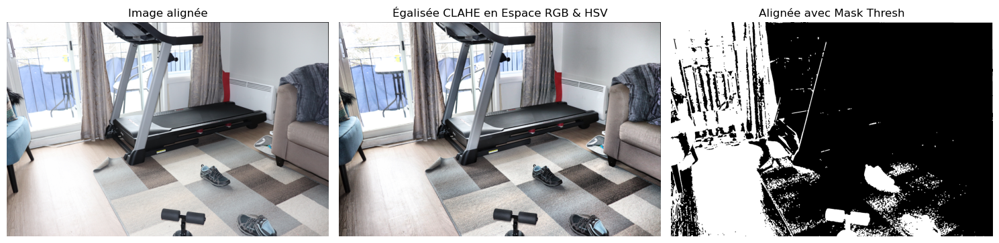

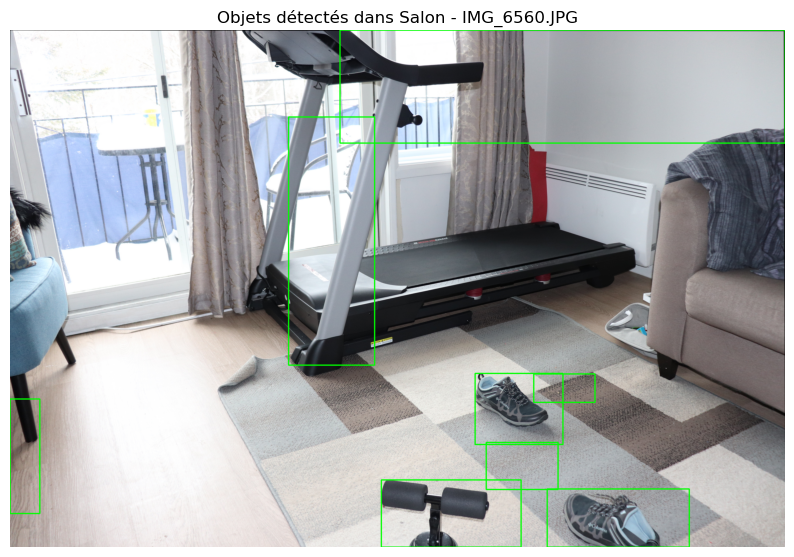

Nombre de bonnes correspondances après le ratio test : 328


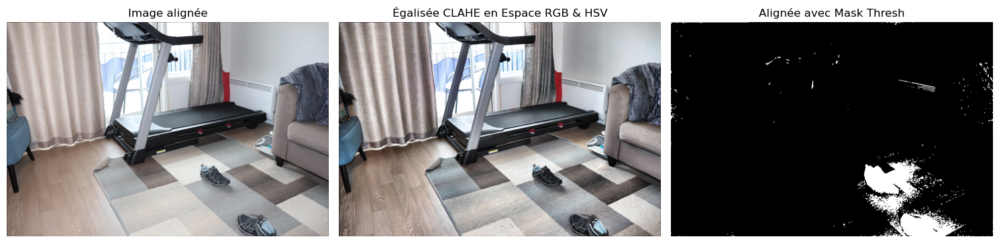

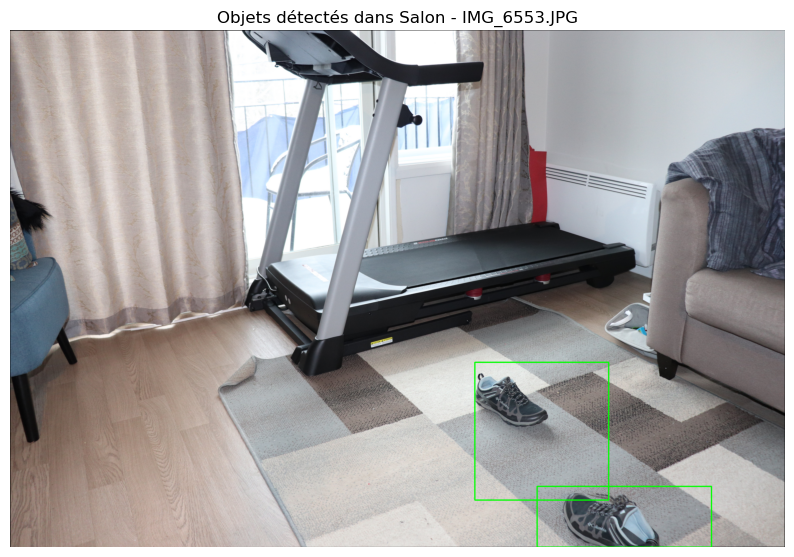

Nombre de bonnes correspondances après le ratio test : 341


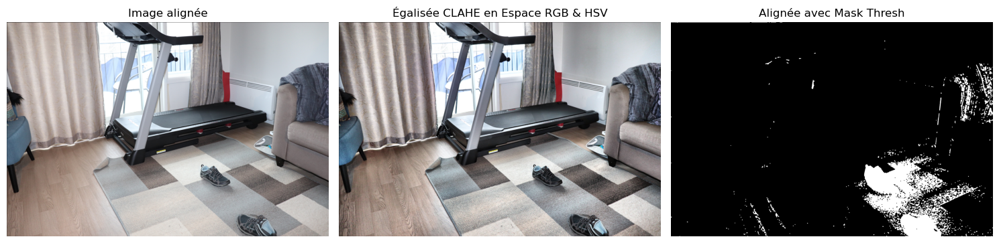

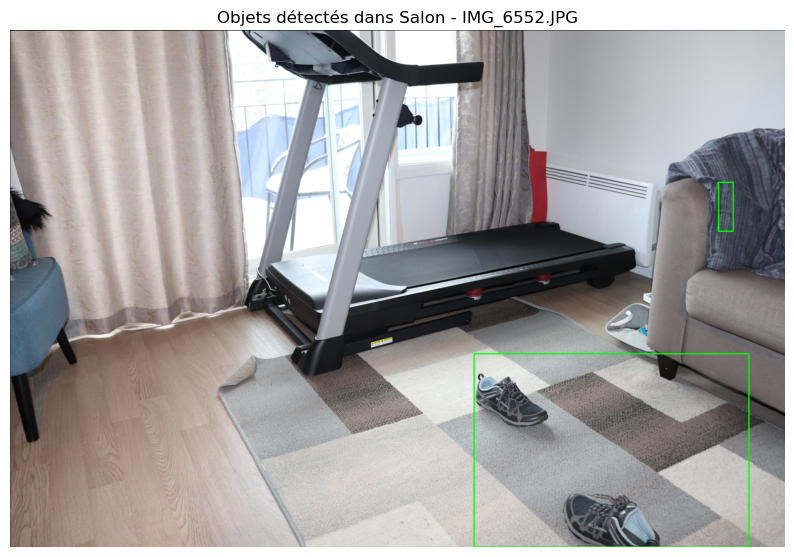

Nombre de bonnes correspondances après le ratio test : 336


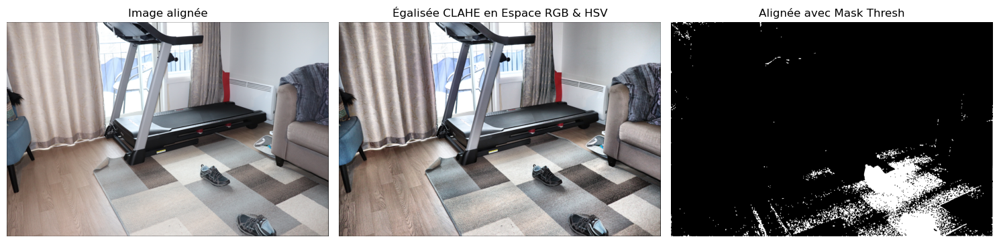

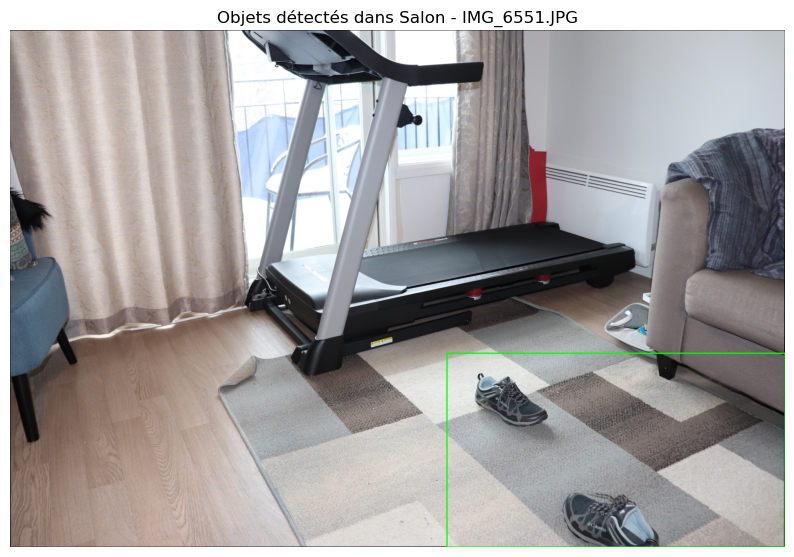

Nombre de bonnes correspondances après le ratio test : 144


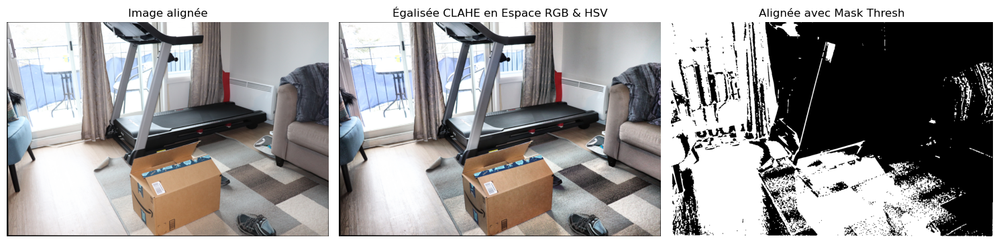

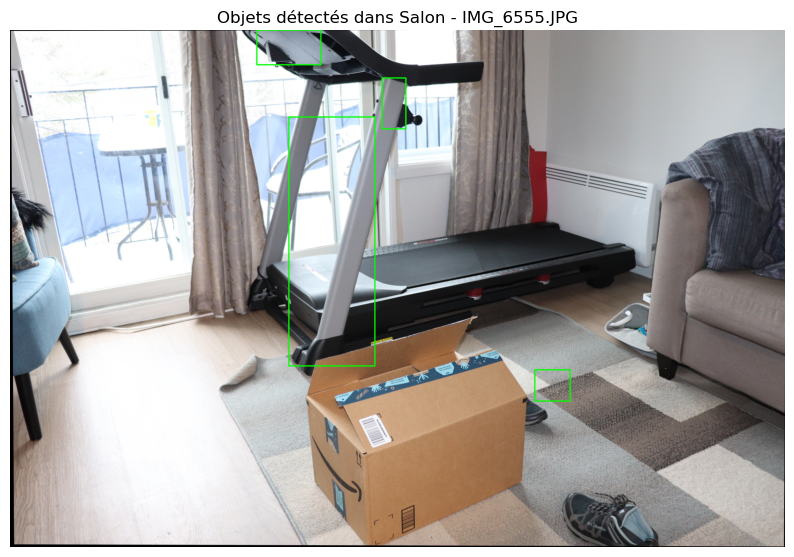

Nombre de bonnes correspondances après le ratio test : 198


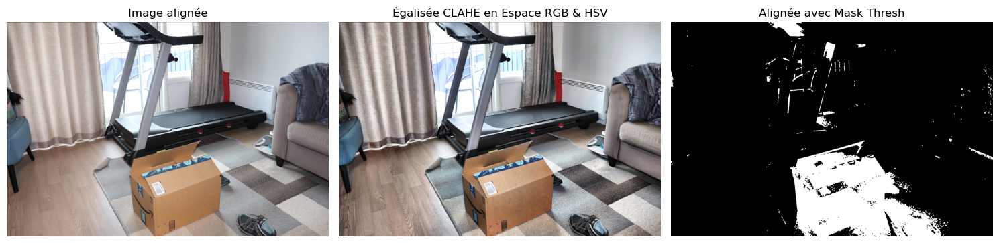

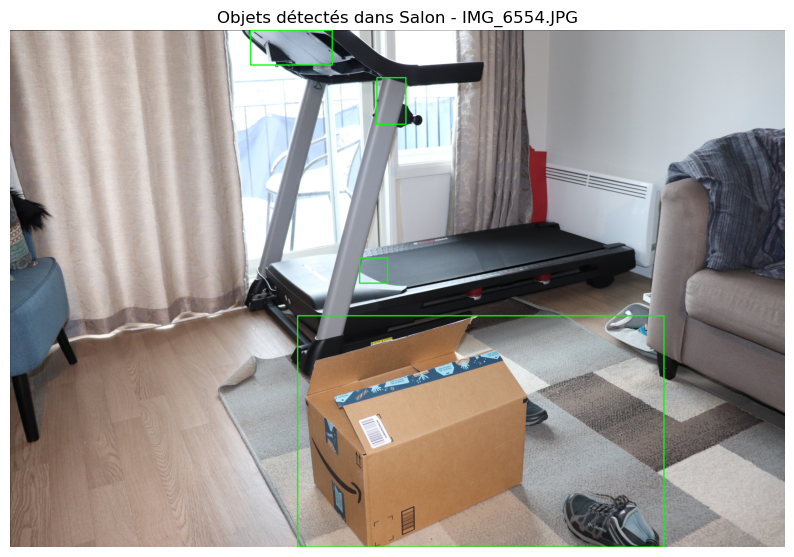

Nombre de bonnes correspondances après le ratio test : 192


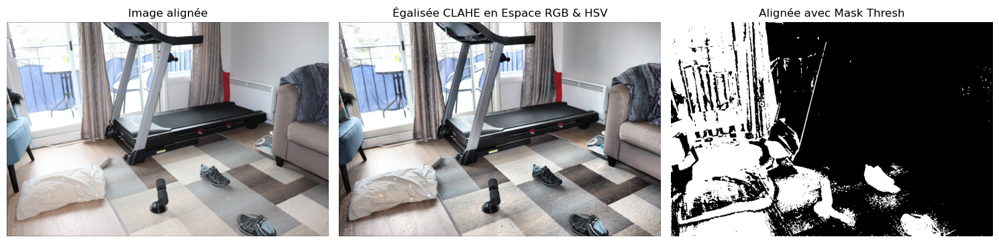

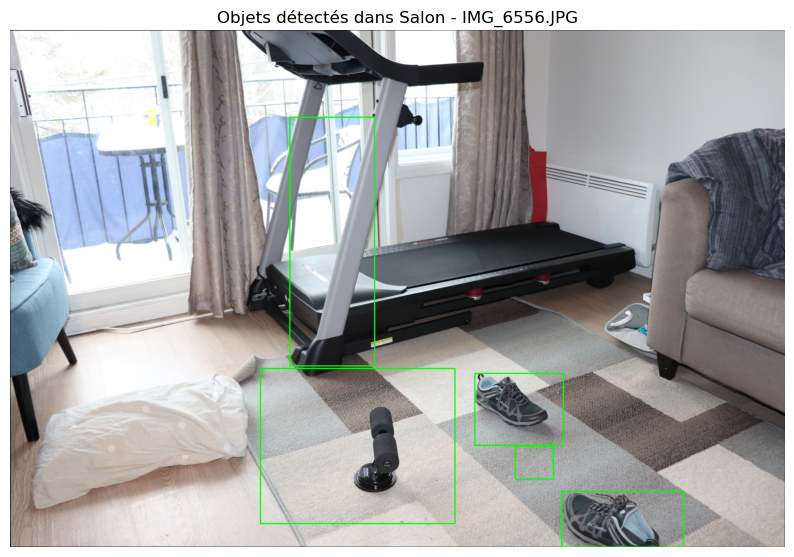

Nombre de bonnes correspondances après le ratio test : 153


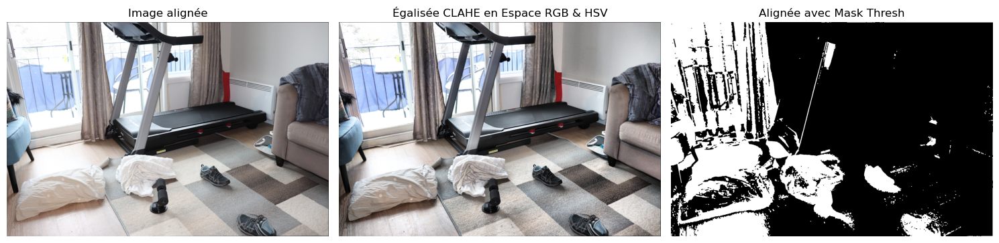

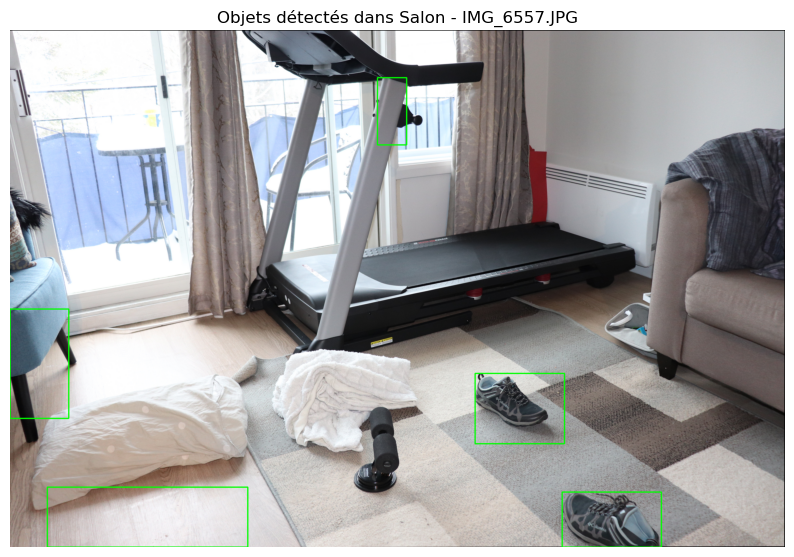

Nombre de bonnes correspondances après le ratio test : 173


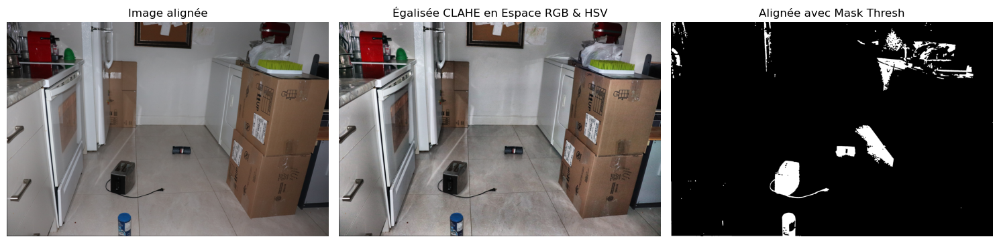

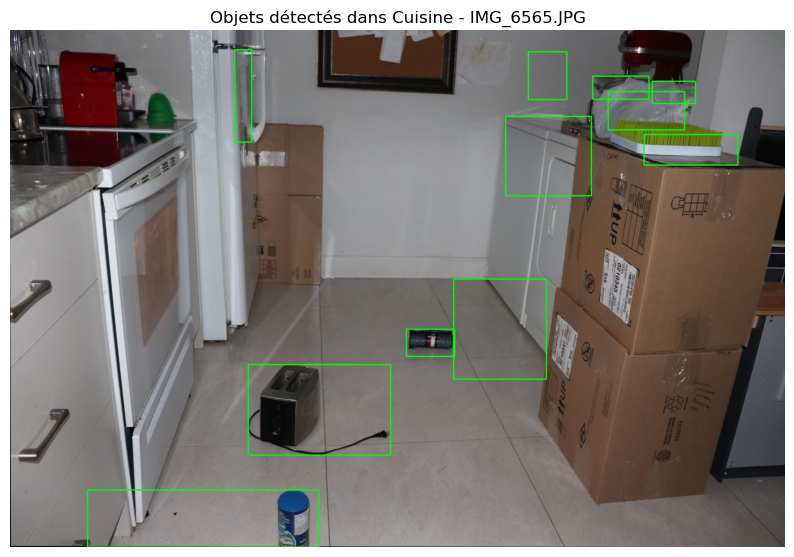

Nombre de bonnes correspondances après le ratio test : 224


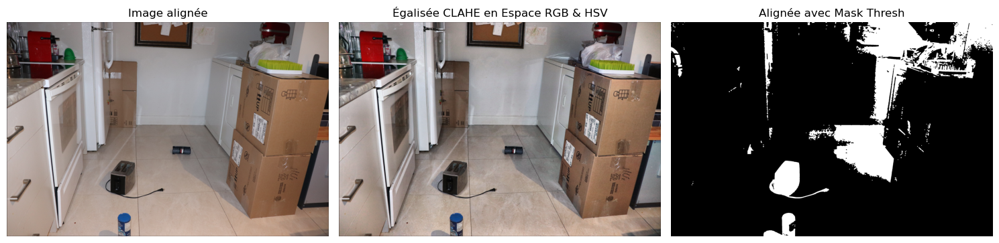

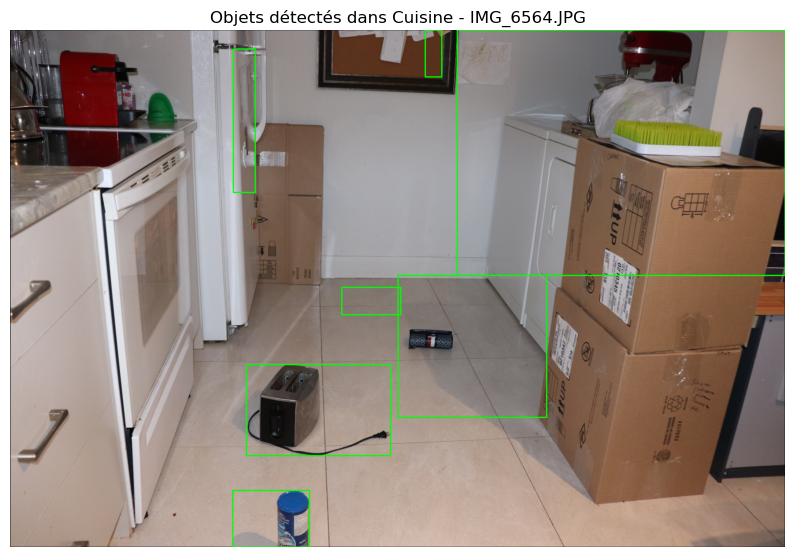

Nombre de bonnes correspondances après le ratio test : 294


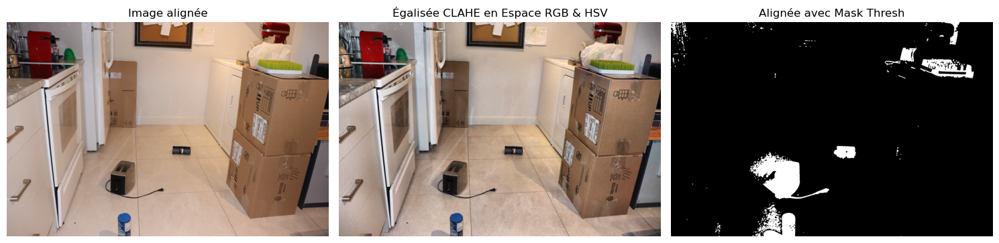

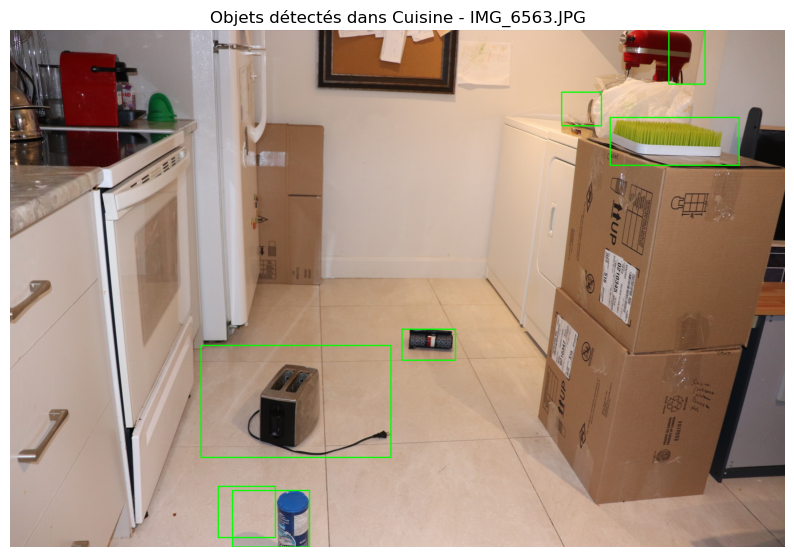

Nombre de bonnes correspondances après le ratio test : 353


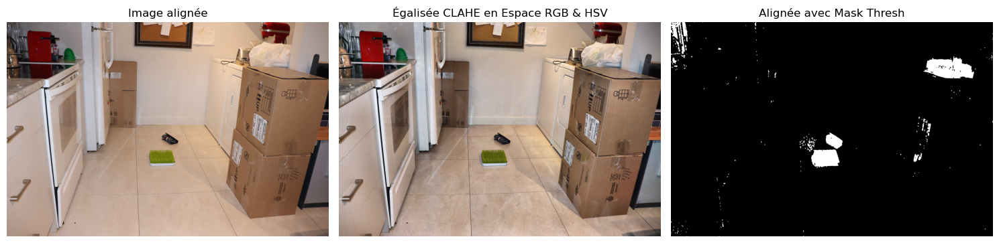

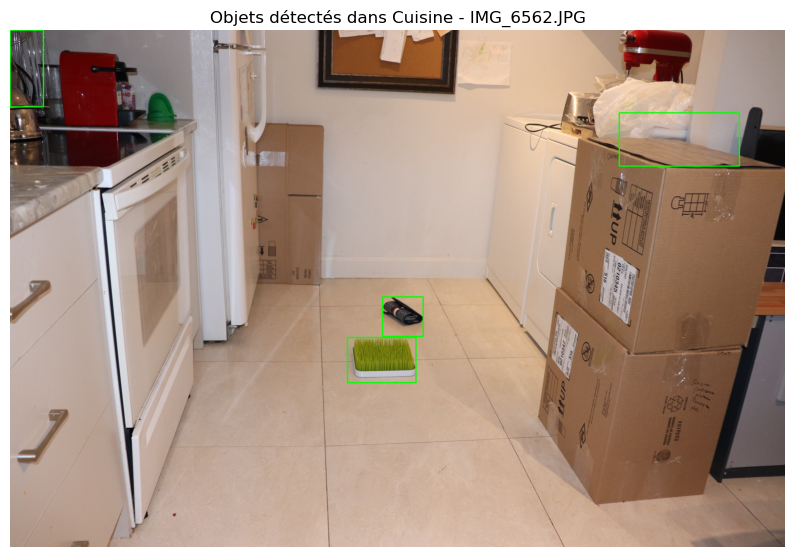

In [22]:
# Parcours des sous-dossiers et traitement des images
for dir in sub_dirs:
    dir_path = os.path.join(root_dir, dir)


    # Chargement de l'image de référence
    reference_image_path = os.path.join(dir_path, 'Reference.JPG')
    image_ref = cv2.imread(reference_image_path)
    if image_ref is None:
        raise FileNotFoundError(f"Image de référence non trouvée dans {dir}")

    # Conversion en RGB et redimensionnement
    image_ref_rgb = cv2.cvtColor(image_ref, cv2.COLOR_BGR2RGB)
    image_ref_min = resizer_image(image_ref_rgb, 50) 

    # Appliquer CLAHE sur l'image de référence
    image_ref_clahe_rgb = appliquer_clahe_rgb(image_ref_min)
    image_ref_clahe_hsv = appliquer_clahe_hsv(image_ref_min)

    # Fusionner les résultats avec une pondération
    alpha = 0.5  # Poids pour HSV (luminance améliorée)
    beta = 0.5  # Poids pour RGB (couleurs améliorées)
 
    image_ref_clahe = fusionner_images(image_ref_clahe_hsv, image_ref_clahe_rgb, alpha, beta)

    # Traitement des autres images dans le dossier
    for image_file in os.listdir(dir_path):
        if image_file == 'Reference.JPG': 
            continue

        image_trait_path = os.path.join(dir_path, image_file)
        image_trait = cv2.imread(image_trait_path)
        if image_trait is None:
            print(f"Erreur lors du chargement de l'image : {image_trait_path}")
            continue

        # Conversion et redimensionnement de l'image à traiter
        image_trait_rgb = cv2.cvtColor(image_trait, cv2.COLOR_BGR2RGB)
        image_trait_min = resizer_image(image_trait_rgb, 50) 

        # Aligner les images
        image_trait_alignee, img_matches = aligner_images(image_ref_min, image_trait_min)  

        # Appliquer CLAHE sur l'image alignée
        image_trait_clahe_rgb = appliquer_clahe_rgb(image_trait_alignee)
        image_trait_clahe_hsv = appliquer_clahe_hsv(image_trait_alignee)


        # Fusionner les résultats avec une pondération
        alpha = 0.5  # Poids pour HSV (luminance améliorée)
        beta = 0.5  # Poids pour RGB (couleurs améliorées)
        image_fusionnee = fusionner_images(image_trait_clahe_hsv, image_trait_clahe_rgb, alpha, beta)

        # Soustraction d'arrière-plan et détection de contours
        mask = soustraction_arriere_plan(image_ref_clahe, image_fusionnee)
        contours = detecter_contours(mask)

        # Affichage des résultats
        plt.figure(figsize=(15, 8))

        # Image alignée
        plt.subplot(1, 3, 1)
        plt.imshow(image_trait_alignee)
        plt.title('Image alignée')
        plt.axis('off')

        # Image fusionnée après CLAHE
        plt.subplot(1, 3, 2)
        plt.imshow(image_fusionnee)
        plt.title("Égalisée CLAHE en Espace RGB & HSV")
        plt.axis('off')

        # Masque obtenu après soustraction d'arrière-plan
        plt.subplot(1, 3, 3)
        plt.imshow(mask, cmap='gray')
        plt.title("Alignée avec Mask Thresh")
        plt.axis('off')

        plt.tight_layout()

        # Dessin des contours sur l'image alignée
        image_contours = tracer_contour(image_trait_alignee, contours,min_area=5500, max_area=770000)

        # Afficher l'image avec contours
        plt.figure(figsize=(10, 8))
        plt.imshow(image_contours)
        plt.title(f'Objets détectés dans {dir} - {image_file}')
        plt.axis('off')
        plt.show()